# **SSC0957 - Prática em Ciência de Dados II**
---

### **Alunos:**
> #### Arthur Santorum Lorenzetto - 12559465
> #### André Guarnier De Mitri    - 11395579
> #### Rui Emanuel Lima Vieira    - 11819182

### **Professor:** Alexandre Claudio Botazzo Delbem
---


Este trabalho utilizou dados disponibilizados pelo repositório COVID-19 Data Sharing/BR, disponível em:
https://repositoriodatasharingfapesp.uspdigital.usp.br/".


# 1. Introdução

# Carregando Dados


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns

In [ ]:
!gdown 1S3O9nbhfsWv5QX1vb8nSsNjQUBkpuGJT

Downloading...
From: https://drive.google.com/uc?id=1S3O9nbhfsWv5QX1vb8nSsNjQUBkpuGJT
To: /content/casos_agrupados.parquet
100% 26.4M/26.4M [00:00<00:00, 154MB/s] 


In [ ]:
casos = pd.read_parquet('casos_agrupados.parquet', engine='pyarrow')
casos.head()

,regiao_FIOCRUZ,estado_FIOCRUZ,municipio_FIOCRUZ,coduf_FIOCRUZ,codmun_FIOCRUZ,codRegiaoSaude_FIOCRUZ,nomeRegiaoSaude_FIOCRUZ,data_FIOCRUZ,semanaEpi_FIOCRUZ,populacaoTCU2019_FIOCRUZ,...,pneumopatia_pre,puerpera_pre,sindrome_de_down_pre,estado,QUANTIDADE_TIPO_TRANSPORTE_respiradores_pedido,QUANTIDADE_TIPO_UTI_respiradores_pedido,QUANTIDADE_TIPO_TRANSPORTE_USA_respiradores_pedido,QUANTIDADE_TIPO_TRANSPORTE_respiradores_entrega,QUANTIDADE_TIPO_UTI_respiradores_entrega,QUANTIDADE_TIPO_TRANSPORTE_USA_respiradores_entrega
0,Norte,RO,ALTA FLORESTA D'OESTE,11,110001.0,11005.0,ZONA DA MATA,2020-04-10,15,22945.0,...,None,None,None,None,NaN,NaN,NaN,NaN,NaN,NaN
1,Norte,RO,ALTA FLORESTA D'OESTE,11,110001.0,11005.0,ZONA DA MATA,2020-04-11,15,22945.0,...,None,None,None,None,NaN,NaN,NaN,NaN,NaN,NaN
2,Norte,RO,ALTA FLORESTA D'OESTE,11,110001.0,11005.0,ZONA DA MATA,2020-04-12,16,22945.0,...,None,None,None,None,NaN,NaN,NaN,NaN,NaN,NaN
3,Norte,RO,ALTA FLORESTA D'OESTE,11,110001.0,11005.0,ZONA DA MATA,2020-04-13,16,22945.0,...,None,None,None,None,NaN,NaN,NaN,NaN,NaN,NaN
4,Norte,RO,ALTA FLORESTA D'OESTE,11,110001.0,11005.0,ZONA DA MATA,2020-04-14,16,22945.0,...,None,None,None,None,NaN,NaN,NaN,NaN,NaN,NaN


# Análise Exploratória Casos e Óbitos

In [ ]:
casos.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2111030 entries, 0 to 2111029
Data columns (total 67 columns):
 #   Column                                               Dtype         
---  ------                                               -----         
 0   regiao_FIOCRUZ                                       object        
 1   estado_FIOCRUZ                                       object        
 2   municipio_FIOCRUZ                                    object        
 3   coduf_FIOCRUZ                                        int64         
 4   codmun_FIOCRUZ                                       float64       
 5   codRegiaoSaude_FIOCRUZ                               float64       
 6   nomeRegiaoSaude_FIOCRUZ                              object        
 7   data_FIOCRUZ                                         datetime64[ns]
 8   semanaEpi_FIOCRUZ                                    int64         
 9   populacaoTCU2019_FIOCRUZ                             float64       
 10  casosA

In [ ]:
# Definindo funções
def retorna_dados_lista(name,lista_idade,indice_lista):
    if(len(indice_lista[0]) == 0):
        return np.nan
    else:
        return lista_idade[indice_lista]

def df_explode_idade(df,obito=None):
    return df.query("obito_pre == obito_pre") \
                 .assign(index = lambda x: x["obito_pre"].apply(lambda y: np.where(y == obito) if obito is not None
                                                                                           else np.where(y >= 0))) \
                 .assign(idade = lambda x: x.apply(lambda y: retorna_dados_lista(y.name,
                                                                                 y['idade_pre'],
                                                                                 y['index']),
                                                         axis=1),
                        sexo = lambda x: x.apply(lambda y: retorna_dados_lista(y.name,
                                                                                 y['cs_sexo_pre'],
                                                                                 y['index']),
                                                         axis=1)).explode(["idade","sexo"])

def hist_individuos_contaminados(df, title, obito=None):
    df_exploded = df_explode_idade(df, obito)
    fig = px.histogram(
        df_exploded, x="idade", nbins=40, title=title,
        labels={"idade": "Idade"}
    )
    fig.update_layout(yaxis_title="Quantidade de pessoas")
    fig.show()

In [ ]:
hist_individuos_contaminados(casos,"Histograma da idade dos indivíduos contaminados")

In [ ]:
hist_individuos_contaminados(casos,"Histograma da idade dos indivíduos que APENAS se contaminaram no período apurado",0)

In [ ]:
hist_individuos_contaminados(casos,"Histograma da idade dos indivíduos que vieram a falecer no período apurado",1)

In [ ]:
# Criar um gráfico de histograma para o primeiro conjunto de dados
fig1 = px.histogram(df_explode_idade(casos).idade, nbins=19)

# Criar um gráfico de histograma para o segundo conjunto de dados
fig2 = px.histogram(df_explode_idade(casos, 1).idade, nbins=19)

# Criar um subplot com os dois gráficos de histograma
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2, subplot_titles=["Contaminados", "Óbitos"])
fig.update_layout(title_text= "Contaminados x Óbitos", showlegend=False)
fig.add_trace(fig1.data[0], row=1, col=1)
fig.add_trace(fig2.data[0], row=1, col=2)
fig.update_xaxes(title_text="Idade")
fig.update_yaxes(title_text="Quantidade de pessoas")

# Mostrar o subplot
fig.show()

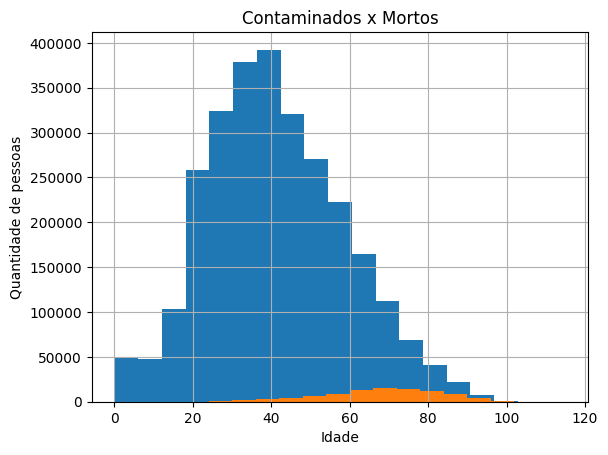

In [ ]:
df_explode_idade(casos).idade.hist(bins=19)
df_explode_idade(casos,1).idade.hist(bins=19)

plt.title("Contaminados x Mortos")
plt.xlabel("Idade")
plt.ylabel("Quantidade de pessoas")
plt.show()

In [ ]:
casos = casos.assign(nao_morte = lambda x: x["obito_pre"].apply(lambda y: len(np.where(y == 0)[0])),
                             morte = lambda x: x["obito_pre"].apply(lambda y: len(np.where(y == 1)[0])))

def obitos_nao_obitos_contaminados(df):
    return df.melt(id_vars = ["municipio_FIOCRUZ","data_FIOCRUZ"],value_vars = ['nao_morte','morte'],
                                            var_name = 'situacao',value_name='quantidade') \
             .groupby("situacao").quantidade.sum().reset_index() \
             .assign(perc_quantidade = lambda x: 100*x["quantidade"]/x["quantidade"].sum())

obitos_nao_obitos_contaminados(casos)

,situacao,quantidade,perc_quantidade
0,morte,90639,3.251319
1,nao_morte,2697122,96.748681


In [ ]:
 # Casos por município
def volume_casos(df):
    return df.groupby("municipio_FIOCRUZ").casosNovos_FIOCRUZ.sum().sort_values(ascending=False)

volume_casos(casos).head(20)

municipio_FIOCRUZ
SAO PAULO         693984
BRASILIA          371192
RIO DE JANEIRO    250192
FORTALEZA         194078
SALVADOR          185698
MANAUS            166951
BELO HORIZONTE    165877
CURITIBA          144960
GOIANIA           132937
PORTO ALEGRE      117594
RECIFE             99771
ARACAJU            95861
BELEM              95373
CAMPO GRANDE       93531
UBERLANDIA         87220
JOINVILLE          83716
TERESINA           83305
JOAO PESSOA        77181
CAMPINAS           74676
CUIABA             74429
Name: casosNovos_FIOCRUZ, dtype: int64

# Plots Comorbidades

In [ ]:
comorbidades = ['asma_pre',
                 'cardiopatia_pre',
                 'diabetes_pre',
                 'doenca_hematologica_pre',
                 'doenca_hepatica_pre',
                 'doenca_neurologica_pre',
                 'doenca_renal_pre',
                 'imunodepressao_pre',
                 'obesidade_pre',
                 'outros_fatores_de_risco_pre',
                 'pneumopatia_pre',
                 'puerpera_pre',
                 'sindrome_de_down_pre']

In [ ]:
def explode_comorbidade_df(df):
    explode = df[["municipio_FIOCRUZ","data_FIOCRUZ","obito_pre","cs_sexo_pre","idade_pre"]+comorbidades] \
                             .explode(["idade_pre",'obito_pre','cs_sexo_pre']+comorbidades).reset_index(drop=True) \
                             .assign(alguma_comorbidade = lambda x: (x[comorbidades]=="sim") \
                                                                           .apply(lambda y: any(y),axis=1),
                                     totalmente_ignorado = lambda x: (x[comorbidades]=="ignorado") \
                                                                       .apply(lambda y: all(y),axis=1)) \
                             .assign(alguma_comorbidade = lambda x: np.where(x["alguma_comorbidade"] == True,"sim",
                                                                          np.where(x["totalmente_ignorado"] == True,
                                                                                    "ignorado",
                                                                                    "não")))
    return explode

casos_explode = explode_comorbidade_df(casos)

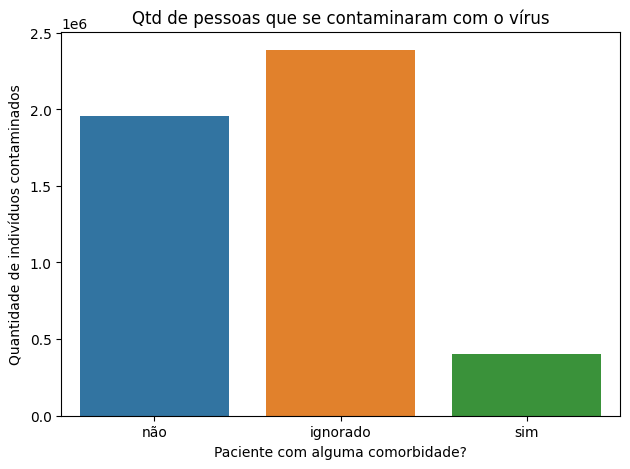

In [ ]:
sns.countplot(data = casos_explode,x = "alguma_comorbidade")
plt.title("Qtd de pessoas que se contaminaram com o vírus")
plt.tight_layout()
plt.xlabel("Paciente com alguma comorbidade?")
plt.ylabel("Quantidade de indivíduos contaminados")
plt.show()

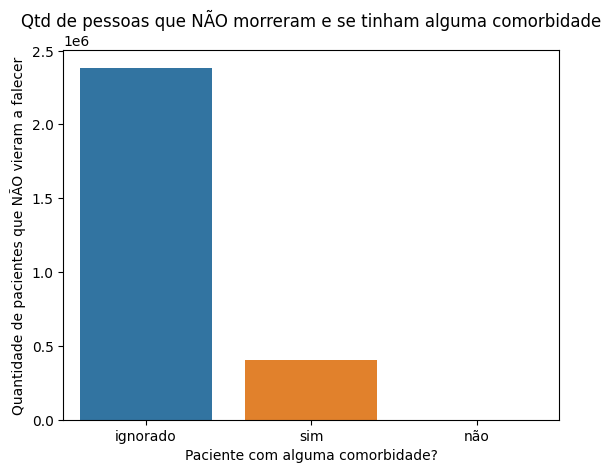

In [ ]:
# Nota-se que há uma diferença entre ter alguma comorbidade e os casos com óbito: existe uma relação entre eles
sns.countplot(data = casos_explode.query("obito_pre == 0 or obito_pre == obito_pre"),x = "alguma_comorbidade")
plt.title("Qtd de pessoas que NÃO morreram e se tinham alguma comorbidade")
plt.xlabel("Paciente com alguma comorbidade?")
plt.ylabel("Quantidade de pacientes que NÃO vieram a falecer")
plt.show()

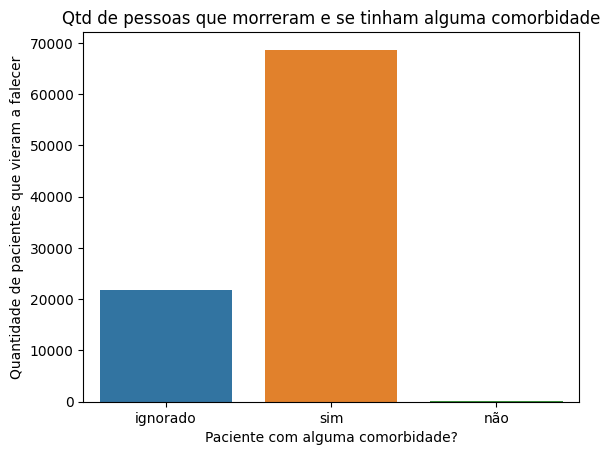

In [ ]:
# Nota-se que há uma diferença entre ter alguma comorbidade e os casos com óbito: existe uma relação entre eles
sns.countplot(data = casos_explode.query("obito_pre == 1"),x = "alguma_comorbidade")
plt.title("Qtd de pessoas que morreram e se tinham alguma comorbidade")
plt.xlabel("Paciente com alguma comorbidade?")
plt.ylabel("Quantidade de pacientes que vieram a falecer")
plt.show()

In [ ]:
fig = px.bar(casos_explode.query("obito_pre == 1 & alguma_comorbidade == 'sim'") \
                                    .melt(id_vars=['municipio_FIOCRUZ','data_FIOCRUZ','obito_pre','idade_pre'],
                                            value_vars=comorbidades,
                                            value_name="existencia_comorbidade",
                                            var_name= "comorbidade") \
                                    .query("existencia_comorbidade == 'sim'")\
                                    .pivot_table(index='comorbidade',columns="obito_pre",values="existencia_comorbidade",aggfunc="count")\
                                    .reset_index().sort_values(by=1),
             x=1,
             y='comorbidade',
             orientation='h',  # Definindo a orientação como horizontal
             labels={'1': 'Quantidade de pessoas contaminadas', 'comorbidade': 'Comorbidade'},
             title="Quantidade de pessoas contaminadas e comorbidades"
             )

fig.show()

In [ ]:
uma_comorbidade = casos_explode[comorbidades].apply(lambda row: row.eq('sim').sum() == 1, axis=1)

In [ ]:
df_unica_comorbidade = casos_explode[uma_comorbidade]
df_duas_mais_comorbidade = casos_explode[~uma_comorbidade].query("alguma_comorbidade == 'sim'")

In [ ]:
# Universo geral das comorbidades
fig = px.bar(casos_explode.query("alguma_comorbidade == 'sim'") \
                .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
                      value_vars=comorbidades,
                      value_name="existencia_comorbidade",
                      var_name="comorbidade") \
                .query("existencia_comorbidade == 'sim'") \
                .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
                .rename(columns={0: "nao_obito", 1: "obito"})
                .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"])*100)
                .reset_index().sort_values("perc", ascending=True),
              x="perc", y='comorbidade',
             title="Percentual de mortes e comorbidades",
              labels={"comorbidade": "Comorbidade", "perc": "Percentual de óbitos"})

# Exibe o gráfico
fig.show()

In [ ]:
# Universo das comorbidades isoladas, pessoas com apenas uma comorbidade
fig = px.bar(df_unica_comorbidade.melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
                                        value_vars=comorbidades,
                                        value_name="existencia_comorbidade",
                                        var_name="comorbidade") \
                .query("existencia_comorbidade == 'sim'") \
                .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
                .rename(columns={0: "nao_obito", 1: "obito"})
                .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"])*100)
                .reset_index().sort_values("perc", ascending=True),
              x="perc", y='comorbidade',
              title="Percentual de óbitos por pessoas com APENAS UMA comorbidade",
              labels={"comorbidade": "Comorbidade", "perc": "Percentual de óbitos"})

# Exibe o gráfico
fig.show()

In [ ]:
# Universo das comorbidades conjuntas, pessoas com duas ou mais comorbidades
fig = px.bar(df_duas_mais_comorbidade \
                .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
                      value_vars=comorbidades,
                      value_name="existencia_comorbidade",
                      var_name="comorbidade") \
                .query("existencia_comorbidade == 'sim'") \
                .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
                .rename(columns={0: "nao_obito", 1: "obito"})
                .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"])*100)
                .reset_index().sort_values("perc", ascending=True),
              x="perc", y='comorbidade',
              title="Percentual de óbitos por pessoas com DUAS OU MAIS comorbidades",
              labels={"comorbidade": "Comorbidade", "perc": "Percentual de óbitos"})

# Exibe o gráfico
fig.show()

In [ ]:
# Calculando o percentual de óbitos para pessoas com apenas uma comorbidade
perc_obito_unica_comorbidade = df_unica_comorbidade['obito_pre'].sum() / len(df_unica_comorbidade) * 100

# Calculando o percentual de óbitos para pessoas com duas ou mais comorbidades
perc_obito_duas_mais_comorbidades = df_duas_mais_comorbidade['obito_pre'].sum() / len(df_duas_mais_comorbidade) * 100

# Calculando a divisão do percentual de óbitos entre pessoas com duas ou mais comorbidades pelo percentual de óbitos de pessoas com apenas uma comorbidade
divisao_percentual = perc_obito_duas_mais_comorbidades / perc_obito_unica_comorbidade

print(f"O percentual de óbitos para pessoas com DUAS OU MAIS comorbidades é {perc_obito_duas_mais_comorbidades:.2f}%")
print(f"O percentual de óbitos para pessoas com APENAS UMA comorbidade é {perc_obito_unica_comorbidade:.2f}%")
print(f"A divisão do percentual de óbitos entre pessoas com DUAS OU MAIS comorbidades pelo percentual de óbitos de pessoas com APENAS UMA comorbidade é {divisao_percentual:.2f}")


O percentual de óbitos para pessoas com DUAS OU MAIS comorbidades é 29.37%
O percentual de óbitos para pessoas com APENAS UMA comorbidade é 10.59%
A divisão do percentual de óbitos entre pessoas com DUAS OU MAIS comorbidades pelo percentual de óbitos de pessoas com APENAS UMA comorbidade é 2.77


In [ ]:
# Calculando os percentuais de óbitos para pessoas com APENAS UMA comorbidade
unica_comorbidade_perc = df_unica_comorbidade \
    .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
          value_vars=comorbidades,
          value_name="existencia_comorbidade",
          var_name="comorbidade") \
    .query("existencia_comorbidade == 'sim'") \
    .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
    .rename(columns={0: "nao_obito", 1: "obito"}) \
    .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"]) * 100) \
    .reset_index()

# Calculando os percentuais de óbitos para pessoas com DUAS OU MAIS comorbidades
duas_mais_comorbidades_perc = df_duas_mais_comorbidade \
    .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
          value_vars=comorbidades,
          value_name="existencia_comorbidade",
          var_name="comorbidade") \
    .query("existencia_comorbidade == 'sim'") \
    .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
    .rename(columns={0: "nao_obito", 1: "obito"}) \
    .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"]) * 100) \
    .reset_index()

# Join entre os dois DataFrames pelas colunas 'comorbidade' para calcular a divisão
merged_df = pd.merge(unica_comorbidade_perc, duas_mais_comorbidades_perc, on='comorbidade', suffixes=('_unica', '_duas_mais'))

# Calculando a divisão do percentual de óbitos para cada comorbidade
merged_df['aumento'] = merged_df['perc_duas_mais'] / merged_df['perc_unica']

# Exiba o DataFrame resultante com a divisão do percentual de óbitos por comorbidade
merged_df[['comorbidade', 'aumento']].sort_values(by='aumento', ascending=False)

obito_pre,comorbidade,aumento_percentual
7,imunodepressao_pre,6.872734
2,diabetes_pre,3.997620
1,cardiopatia_pre,3.597092
6,doenca_renal_pre,3.456624
0,asma_pre,2.345654
3,doenca_hematologica_pre,1.716474
11,puerpera_pre,1.702313
8,obesidade_pre,1.671947
9,outros_fatores_de_risco_pre,1.461257
10,pneumopatia_pre,1.375200


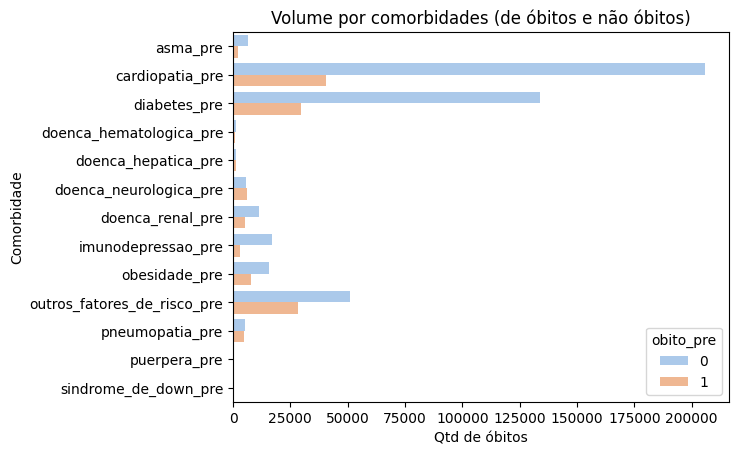

In [ ]:
# Vendo se uma comorbidade sobresai
palette = sns.color_palette("pastel")

sns.countplot(data =
                    casos_explode.query("alguma_comorbidade == 'sim'") \
                                    .melt(id_vars=['municipio_FIOCRUZ','data_FIOCRUZ','obito_pre','idade_pre'],
                                            value_vars=comorbidades,
                                            value_name="existencia_comorbidade",
                                            var_name= "comorbidade") \
                                    .query("existencia_comorbidade == 'sim'"),
              y='comorbidade',
              hue="obito_pre",
              palette=palette)
plt.title("Volume por comorbidades (de óbitos e não óbitos)")
plt.xlabel("Qtd de óbitos")
plt.ylabel("Comorbidade")
plt.show()

In [ ]:
relacao = casos_explode.groupby(["obito_pre","alguma_comorbidade"], dropna=False).size().reset_index(name='qnt')

# quantidade de obitos COM comorbidade frente a todos os obitos
relacao_comorbidade_obito = relacao.query("alguma_comorbidade == 'sim' & obito_pre == 1") \
                                    ["qnt"].sum() / relacao.query("obito_pre == 1")["qnt"].sum()

# quantidade de pessoas COM comorbidade frente a todos as pessoas contaminadas
relacao_comorbidade = relacao.query("alguma_comorbidade == 'sim'")["qnt"].sum()/relacao["qnt"].sum()

print("RCCO = Relação de COM comorbidades associadas aos óbitos",round(relacao_comorbidade_obito*100,2),"%")
print("RCC = Relação de COM comorbidades associadas à população contaminada",round(relacao_comorbidade*100,2),"%")
print("Relação RCCO/RCC",round(relacao_comorbidade_obito/relacao_comorbidade,2))
print('=========================================================================')

# quantidade de obitos SEM comorbidade frente a todos os obitos
relacao_nao_como_obito = relacao.query("alguma_comorbidade == 'não' & obito_pre == 1") \
                                    ["qnt"].sum() / relacao.query("obito_pre == 1")["qnt"].sum()

# quantidade de pessoas SEM comorbidade frente a todos as pessoas contaminadas
relacao_nao_como = relacao.query("alguma_comorbidade == 'não'")["qnt"].sum()/relacao["qnt"].sum()

print("RSCO = Relação de SEM comorbidades associadas aos óbitos",round(relacao_nao_como_obito*100,2),"%")
print("RSC = Relação de SEM comorbidades associadas à população contaminada",round(relacao_nao_como*100,2),"%")
print("Relação RSCO/RSC",round(relacao_nao_como_obito/relacao_nao_como,3))
print('=========================================================================')

# quantidade de obitos com comorbidade IGNORADO frente a todos os obitos
relacao_igno_como_obito = relacao.query("alguma_comorbidade == 'ignorado' & obito_pre == 1") \
                                    ["qnt"].sum() / relacao.query("obito_pre == 1")["qnt"].sum()

# quantidade de pessoas com comorbidade IGNORADO frente a todos as pessoas contaminadas
relacao_igno_como = relacao.query("alguma_comorbidade == 'ignorado'")["qnt"].sum()/relacao["qnt"].sum()

print("RICO = Relação de comorbidades IGNORADO associadas aos óbitos",round(relacao_igno_como_obito*100,2),"%")
print("RIC = Relação de comorbidades IGNORADO associadas à população contaminada",round(relacao_igno_como*100,2),"%")
print("Relação RICO/RINC",round(relacao_igno_como_obito/relacao_igno_como,2))

RCCO = Relação de COM comorbidades associadas aos óbitos 75.75 %
RCC = Relação de COM comorbidades associadas à população contaminada 8.49 %
Relação RCCO/RCC 8.92
RSCO = Relação de SEM comorbidades associadas aos óbitos 0.11 %
RSC = Relação de SEM comorbidades associadas à população contaminada 41.25 %
Relação RSCO/RSC 0.003
RICO = Relação de comorbidades IGNORADO associadas aos óbitos 24.14 %
RIC = Relação de comorbidades IGNORADO associadas à população contaminada 50.26 %
Relação RICO/RINC 0.48


## Quebra por Faixa Etária

In [ ]:
def constroi_faixa_etaria(b):
    fe = []
    for b0,b1 in zip(b,b[1:]):
        if b0 > 0:
            b_menor = b0 + 1
        else:
            b_menor = b0
        b_maior = b1

        if b_maior == np.inf:
            fe.append("%s anos ou mais" % (b_menor))
        else:
            fe.append("%s a %s anos"%(b_menor,b_maior))

    return fe

bins = [0,4,9,14,19,24,29,34,39,44,49,54,59,64,69,74,79,89,99,np.inf]
faixa_etaria = constroi_faixa_etaria(bins)

# def constroi_faixa_etaria_cut(x):
#     return "%s a %s anos" %(x.left,x.right)
def constroi_faixa_etaria_cut(x):
    if x.right == np.inf:
        return "%s anos ou mais" % x.left
    return "%s a %s anos" % (x.left, x.right)

# def criar_base_rc_faixa_etaria(df,bins_,coluna_comorbidade):
#     b_rc_fe = df.query("idade_pre == idade_pre") \
#      .assign(Faixa_etaria = lambda x: pd.cut(x["idade_pre"],bins=bins_,include_lowest=True)) \
#                                  .assign(Faixa_etaria = lambda x: x["Faixa_etaria"] \
#                                                                      .apply(lambda y: constroi_faixa_etaria_cut(y)) \
#                                                                      .astype("str").str \
#                                                                                  .replace("nan","%s anos ou mais"%bins_[-1])) \
#                                 .assign(Idade = lambda x: pd.Categorical(x['Faixa_etaria'],
#                                                                                 ordered=True,
#                                                                                 categories = faixa_etaria),
#                                         Sexo = lambda x: x.cs_sexo_pre.str.replace("masculino","Homens") \
#                                                                .str.replace("feminino","Mulheres")) \
#                                 .groupby(["Idade","Sexo","obito_pre",coluna_comorbidade]) \
#                                 .municipio_FIOCRUZ.count().reset_index() \
#                                 .rename(columns = {"municipio_FIOCRUZ":"casos"})
#     return b_rc_fe

In [ ]:
faixas_selecionadas = ['-0.001 a 4.0 anos', '34.0 a 39.0 anos', '69.0 a 74.0 anos']

casos_explode_fe = casos_explode.query("idade_pre == idade_pre") \
     .assign(Faixa_etaria = lambda x: pd.cut(x["idade_pre"],bins=bins,include_lowest=True)) \
                                 .assign(Faixa_etaria = lambda x: x["Faixa_etaria"] \
                                                                     .apply(lambda y: constroi_faixa_etaria_cut(y)) \
                                                                     .astype("str").str \
                                                                                 .replace("nan","%s anos ou mais"%bins[-1])) \
                                .assign(Sexo = lambda x: x.cs_sexo_pre.str.replace("masculino","Homens") \
                                                               .str.replace("feminino","Mulheres")) \
                                .query('Faixa_etaria in @faixas_selecionadas')

In [ ]:
# Criando uma lista vazia para armazenar os DataFrames de cada faixa etária
dataframes_faixas = []

# Loop pelas faixas etárias selecionadas
for faixa_etaria_selecionada in faixas_selecionadas:
    # Filtrando o DataFrame para incluir apenas a faixa etária atual
    casos_faixa_etaria = casos_explode_fe[casos_explode_fe['Faixa_etaria'] == faixa_etaria_selecionada]

    # Filtrando e manipulando os dados para pivot_table para cada faixa etária
    df_comorbidades = casos_faixa_etaria.query("alguma_comorbidade == 'sim'") \
                        .melt(id_vars=['municipio_FIOCRUZ','data_FIOCRUZ','idade_pre'],
                              value_vars=comorbidades,
                              value_name="existencia_comorbidade",
                              var_name="comorbidade") \
                        .query("existencia_comorbidade == 'sim'")

    comorbidades_count = df_comorbidades.pivot_table(index='comorbidade',
                                                    values='existencia_comorbidade',
                                                    aggfunc='count').reset_index()

    comorbidades_count['Faixa_etaria'] = faixa_etaria_selecionada  # Adicionando a coluna Faixa_etaria

    # Adicionando o DataFrame da faixa etária atual à lista
    dataframes_faixas.append(comorbidades_count)

# Concatenando os DataFrames de cada faixa etária em um único DataFrame
df_final = pd.concat(dataframes_faixas)
# Ordenando o DataFrame pela quantidade de pessoas contaminadas (existencia_comorbidade) em ordem decrescente
df_final = df_final.sort_values(by='existencia_comorbidade')
# Criando o gráfico de barras agrupadas com o Plotly Express
fig = px.bar(df_final, x='existencia_comorbidade', y='comorbidade', color='Faixa_etaria',
             barmode='group', orientation='h',
             labels={'existencia_comorbidade': 'Quantidade de pessoas contaminadas', 'comorbidade': 'Comorbidade'},
             title='Quantidade de pessoas contaminadas e comorbidades por faixa etária')
fig.show()

In [ ]:
def perc_obitos_comor_faixa_etaria(df, title='Percentual de óbitos e comorbidade por faixa etárias'):
  dataframes_faixas = []

  # Loop pelas faixas etárias selecionadas
  for faixa_etaria_selecionada in faixas_selecionadas:
      # Filtrando o DataFrame para incluir apenas a faixa etária atual
      casos_faixa_etaria = df[df['Faixa_etaria'] == faixa_etaria_selecionada]

      # Filtrando e manipulando os dados
      df_comorbidades = casos_faixa_etaria.query("alguma_comorbidade == 'sim'") \
                                          .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
                                                value_vars=comorbidades,
                                                value_name="existencia_comorbidade",
                                                var_name="comorbidade") \
                                          .query("existencia_comorbidade == 'sim'") \


      comorbidades_count = df_comorbidades.pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
                                              .rename(columns={0: "nao_obito", 1: "obito"}) \
                                              .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"])*100) \
                                              .reset_index().sort_values("perc", ascending=True)

      comorbidades_count['Faixa_etaria'] = faixa_etaria_selecionada  # Adicionando a coluna Faixa_etaria

      # Adicionando o DataFrame da faixa etária atual à lista
      dataframes_faixas.append(comorbidades_count)

  # Concatenando os DataFrames de cada faixa etária em um único DataFrame
  df_final = pd.concat(dataframes_faixas)
  # Ordenando o DataFrame pela quantidade de pessoas contaminadas (existencia_comorbidade) em ordem decrescente
  df_final = df_final.sort_values(by='perc')

  fig = px.bar(df_final, x='perc', y='comorbidade', color='Faixa_etaria',
             barmode='group', orientation='h',
             labels={'perc': 'Percentual de óbitos', 'comorbidade': 'Comorbidade'},
             title= title)

  return fig.show()

In [ ]:
perc_obitos_comor_faixa_etaria(casos_explode_fe)
perc_obitos_comor_faixa_etaria(df_unica_comorbidade_fe, 'Percentual de óbitos por pessoas com APENAS UMA comorbidade por faixa etária')
perc_obitos_comor_faixa_etaria(df_unica_comorbidade_fe, 'Percentual de óbitos por pessoas com DUAS OU MAIS comorbidades por faixa etária')

In [ ]:
uma_comorbidade_fe = casos_explode_fe[comorbidades].apply(lambda row: row.eq('sim').sum() == 1, axis=1)

In [ ]:
df_unica_comorbidade_fe = casos_explode_fe[uma_comorbidade_fe]
df_duas_mais_comorbidade_fe = casos_explode_fe[~uma_comorbidade_fe].query("alguma_comorbidade == 'sim'")

In [ ]:
# Criação de listas para armazenar os resultados
perc_obito_unica_comorbidade_list = []
perc_obito_duas_mais_comorbidades_list = []
divisao_percentual_list = []

# Loop pelas faixas etárias selecionadas
for faixa_etaria in faixas_selecionadas:
    # Filtrando o DataFrame para a faixa etária atual
    df_faixa_etaria_uma = df_unica_comorbidade_fe[df_unica_comorbidade_fe['Faixa_etaria'] == faixa_etaria]

    # Calculando o percentual de óbitos para pessoas com apenas uma comorbidade
    perc_obito_unica_comorbidade = (df_faixa_etaria_uma['obito_pre'].sum() / len(df_faixa_etaria_uma)) * 100

    df_faixa_etaria_duas = df_duas_mais_comorbidade_fe[df_duas_mais_comorbidade_fe['Faixa_etaria'] == faixa_etaria]
    # Calculando o percentual de óbitos para pessoas com duas ou mais comorbidades
    perc_obito_duas_mais_comorbidades = (df_faixa_etaria_duas['obito_pre'].sum() / len(df_faixa_etaria_duas)) * 100

    # Calculando a divisão dos percentuais
    divisao_percentual = perc_obito_duas_mais_comorbidades / perc_obito_unica_comorbidade

    # Adicionando os resultados às listas
    perc_obito_unica_comorbidade_list.append(perc_obito_unica_comorbidade)
    perc_obito_duas_mais_comorbidades_list.append(perc_obito_duas_mais_comorbidades)
    divisao_percentual_list.append(divisao_percentual)

# Exibindo os resultados
for i, faixa_etaria in enumerate(faixas_selecionadas):
    print(f"Para a faixa etária '{faixa_etaria}':")
    print(f"Percentual de óbitos para pessoas com APENAS UMA comorbidade: {perc_obito_unica_comorbidade_list[i]:.2f}%")
    print(f"Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: {perc_obito_duas_mais_comorbidades_list[i]:.2f}%")
    print(f"A divisão dos percentuais: {divisao_percentual_list[i]:.2f}\n")


Para a faixa etária '-0.001 a 4.0 anos':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 3.20%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 9.39%
A divisão dos percentuais: 2.93

Para a faixa etária '34.0 a 39.0 anos':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 3.63%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 15.98%
A divisão dos percentuais: 4.40

Para a faixa etária '69.0 a 74.0 anos':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 18.82%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 35.30%
A divisão dos percentuais: 1.88



In [ ]:
# Criação de listas para armazenar os resultados
perc_obito_unica_comorbidade_list = []
perc_obito_duas_mais_comorbidades_list = []
divisao_percentual_list = []

# Loop pelas faixas etárias selecionadas
for faixa_etaria in faixas_selecionadas:
    for sexo in ['Homens', 'Mulheres']:  # Substitua pelos seus valores de sexo
        # Filtrando o DataFrame para a faixa etária e sexo atual
        df_faixa_etaria_sexo_uma = df_unica_comorbidade_fe[(df_unica_comorbidade_fe['Faixa_etaria'] == faixa_etaria) & (df_unica_comorbidade_fe['Sexo'] == sexo)]

        # Calculando o percentual de óbitos para pessoas com apenas uma comorbidade
        perc_obito_unica_comorbidade = (df_faixa_etaria_sexo_uma['obito_pre'].sum() / len(df_faixa_etaria_sexo_uma)) * 100

        df_faixa_etaria_sexo_duas = df_duas_mais_comorbidade_fe[(df_duas_mais_comorbidade_fe['Faixa_etaria'] == faixa_etaria) & (df_duas_mais_comorbidade_fe['Sexo'] == sexo)]
        # Calculando o percentual de óbitos para pessoas com duas ou mais comorbidades
        perc_obito_duas_mais_comorbidades = (df_faixa_etaria_sexo_duas['obito_pre'].sum() / len(df_faixa_etaria_sexo_duas)) * 100

        # Calculando a divisão dos percentuais
        divisao_percentual = perc_obito_duas_mais_comorbidades / perc_obito_unica_comorbidade

        # Adicionando os resultados às listas
        perc_obito_unica_comorbidade_list.append(perc_obito_unica_comorbidade)
        perc_obito_duas_mais_comorbidades_list.append(perc_obito_duas_mais_comorbidades)
        divisao_percentual_list.append(divisao_percentual)

# Exibindo os resultados
index = 0
for faixa_etaria in faixas_selecionadas:
    for sexo in ['Masculino', 'Feminino']:
        print(f"Para a faixa etária '{faixa_etaria}' e sexo '{sexo}':")
        print(f"Percentual de óbitos para pessoas com APENAS UMA comorbidade: {perc_obito_unica_comorbidade_list[index]:.2f}%")
        print(f"Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: {perc_obito_duas_mais_comorbidades_list[index]:.2f}%")
        print(f"A divisão dos percentuais: {divisao_percentual_list[index]:.2f}\n")
        index += 1

Para a faixa etária '-0.001 a 4.0 anos' e sexo 'Masculino':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 3.09%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 8.08%
A divisão dos percentuais: 2.62

Para a faixa etária '-0.001 a 4.0 anos' e sexo 'Feminino':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 3.32%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 10.98%
A divisão dos percentuais: 3.30

Para a faixa etária '34.0 a 39.0 anos' e sexo 'Masculino':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 4.32%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 17.56%
A divisão dos percentuais: 4.07

Para a faixa etária '34.0 a 39.0 anos' e sexo 'Feminino':
Percentual de óbitos para pessoas com APENAS UMA comorbidade: 3.01%
Percentual de óbitos para pessoas com DUAS OU MAIS comorbidades: 14.34%
A divisão dos percentuais: 4.77

Para a faixa etária '69.0 a 74.0 anos' e sexo 'Masculino':
Percentual de 

In [ ]:
df_resultados = pd.DataFrame()
for faixa_etaria in faixas_selecionadas:

  # Calcule os percentuais de óbitos para pessoas com APENAS UMA comorbidade
  unica_comorbidade_perc = df_unica_comorbidade_fe[(df_unica_comorbidade_fe['Faixa_etaria'] == faixa_etaria)] \
      .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
            value_vars=comorbidades,
            value_name="existencia_comorbidade",
            var_name="comorbidade") \
      .query("existencia_comorbidade == 'sim'") \
      .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
      .rename(columns={0: "nao_obito", 1: "obito"}) \
      .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"]) * 100) \
      .reset_index()

  # Calcule os percentuais de óbitos para pessoas com DUAS OU MAIS comorbidades
  duas_mais_comorbidades_perc = df_duas_mais_comorbidade_fe[(df_duas_mais_comorbidade_fe['Faixa_etaria'] == faixa_etaria)] \
      .melt(id_vars=['municipio_FIOCRUZ', 'data_FIOCRUZ', 'obito_pre', 'idade_pre'],
            value_vars=comorbidades,
            value_name="existencia_comorbidade",
            var_name="comorbidade") \
      .query("existencia_comorbidade == 'sim'") \
      .pivot_table(index='comorbidade', columns="obito_pre", values="existencia_comorbidade", aggfunc="count") \
      .rename(columns={0: "nao_obito", 1: "obito"}) \
      .assign(perc=lambda x: x["obito"] / (x["obito"] + x["nao_obito"]) * 100) \
      .reset_index()

  # Realize um join entre os dois DataFrames pelas colunas 'comorbidade' para calcular a divisão
  merged_df = pd.merge(unica_comorbidade_perc, duas_mais_comorbidades_perc, on='comorbidade', suffixes=('_unica', '_duas_mais'))

  # Calcule a divisão do percentual de óbitos para cada comorbidade
  merged_df['aumento'] = merged_df['perc_duas_mais'] / merged_df['perc_unica']

  # df_resultados = pd.concat([df_resultados, merged_df[['comorbidade', 'aumento']]], axis=1).rename(columns={'comorbidade': f'comorbidade_{faixa_etaria}'})

  if df_resultados.empty:
        df_resultados = merged_df[['comorbidade', 'aumento']].rename(columns={'aumento': f'aumento {faixa_etaria}'})
  else:
        df_resultados = pd.merge(df_resultados, merged_df[['comorbidade', 'aumento']].rename(columns={'aumento': f'aumento {faixa_etaria}'}), on='comorbidade', how='outer')

# Exiba o DataFrame resultante com a divisão do percentual de óbitos por comorbidade
df_resultados.sort_values(by='aumento -0.001 a 4.0 anos', ascending=False)

obito_pre,comorbidade,aumento -0.001 a 4.0 anos,aumento 34.0 a 39.0 anos,aumento 69.0 a 74.0 anos
1,cardiopatia_pre,7.770000,12.040466,2.218225
10,pneumopatia_pre,3.555556,3.076923,1.108817
9,outros_fatores_de_risco_pre,2.350703,2.071057,1.283771
3,doenca_hematologica_pre,1.500000,3.984375,1.239281
5,doenca_neurologica_pre,1.344828,1.284722,1.098230
11,sindrome_de_down_pre,0.305556,1.389474,0.961538
0,asma_pre,NaN,3.574876,1.053539
2,diabetes_pre,NaN,5.610619,2.459352
4,doenca_hepatica_pre,NaN,0.977778,0.782353
6,doenca_renal_pre,NaN,6.724138,1.600000


In [ ]:
for faixa_etaria_selecionada in faixas_selecionadas:
    # Filtrando o DataFrame para incluir apenas a faixa etária atual
    casos_faixa_etaria = casos_explode_fe[casos_explode_fe['Faixa_etaria'] == faixa_etaria_selecionada]

    # Criando o gráfico para a faixa etária atual
    fig = px.bar(casos_faixa_etaria.query("alguma_comorbidade == 'sim'") \
                                        .melt(id_vars=['municipio_FIOCRUZ','data_FIOCRUZ','obito_pre','idade_pre'],
                                              value_vars=comorbidades,
                                              value_name="existencia_comorbidade",
                                              var_name= "comorbidade") \
                                        .query("existencia_comorbidade == 'sim'")\
                                        .pivot_table(index='comorbidade',values="existencia_comorbidade",aggfunc="count")\
                                        .reset_index().sort_values(by='existencia_comorbidade'),
                 x='existencia_comorbidade',
                 y='comorbidade',
                 orientation='h',  # Definindo a orientação como horizontal
                 labels={'1': 'Quantidade de pessoas contaminadas', 'comorbidade': 'Comorbidade'},
                 title=f"Quantidade de pessoas contaminadas e comorbidades (Faixa Etária: {faixa_etaria_selecionada})"
                 )

    fig.show()


# Ideias

- Para plot geográfico plotar percentual da população com +60 pelo percentual de óbito
- Analisar cidades em que quantidade de idosos, jovens, crianças, adultos é mais alta.


In [4]:
casos_sp = casos.query("estado_FIOCRUZ == 'SP'")
casos_sp

,regiao_FIOCRUZ,estado_FIOCRUZ,municipio_FIOCRUZ,coduf_FIOCRUZ,codmun_FIOCRUZ,codRegiaoSaude_FIOCRUZ,nomeRegiaoSaude_FIOCRUZ,data_FIOCRUZ,semanaEpi_FIOCRUZ,populacaoTCU2019_FIOCRUZ,...,pneumopatia_pre,puerpera_pre,sindrome_de_down_pre,estado,QUANTIDADE_TIPO_TRANSPORTE_respiradores_pedido,QUANTIDADE_TIPO_UTI_respiradores_pedido,QUANTIDADE_TIPO_TRANSPORTE_USA_respiradores_pedido,QUANTIDADE_TIPO_TRANSPORTE_respiradores_entrega,QUANTIDADE_TIPO_UTI_respiradores_entrega,QUANTIDADE_TIPO_TRANSPORTE_USA_respiradores_entrega
1238193,Sudeste,SP,ADAMANTINA,35,350010.0,35091.0,ADAMANTINA,2020-04-10,15,35068.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1238194,Sudeste,SP,ADAMANTINA,35,350010.0,35091.0,ADAMANTINA,2020-04-11,15,35068.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1238195,Sudeste,SP,ADAMANTINA,35,350010.0,35091.0,ADAMANTINA,2020-04-12,16,35068.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1238196,Sudeste,SP,ADAMANTINA,35,350010.0,35091.0,ADAMANTINA,2020-04-13,16,35068.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1238197,Sudeste,SP,ADAMANTINA,35,350010.0,35091.0,ADAMANTINA,2020-04-14,16,35068.0,...,[ignorado],[ignorado],[ignorado],SP,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1482643,Sudeste,SP,ESTIVA GERBI,35,355730.0,35141.0,BAIXA MOGIANA,2021-04-19,16,11304.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1482644,Sudeste,SP,ESTIVA GERBI,35,355730.0,35141.0,BAIXA MOGIANA,2021-04-20,16,11304.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1482645,Sudeste,SP,ESTIVA GERBI,35,355730.0,35141.0,BAIXA MOGIANA,2021-04-21,16,11304.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
1482646,Sudeste,SP,ESTIVA GERBI,35,355730.0,35141.0,BAIXA MOGIANA,2021-04-22,16,11304.0,...,None,None,None,SP,NaN,NaN,NaN,NaN,NaN,NaN
